In [5515]:
import requests
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
import numpy as np

from datetime import *
from bs4 import BeautifulSoup
from datetime import datetime
from geopandas import GeoDataFrame

# Scrape (skip)

This section not operational, for eventually scraping directly from page instead of manual download from the tableau dl link

In [5516]:
page = requests.get('https://a816-health.nyc.gov/hdi/epiquery/visualizations?PageType=ps&PopulationSource=Syndromic')
contents = page.content

In [5517]:
contents

b'<!DOCTYPE html>\n<html lang="en" dir="ltr" prefix="content: http://purl.org/rss/1.0/modules/content/  dc: http://purl.org/dc/terms/  foaf: http://xmlns.com/foaf/0.1/  og: http://ogp.me/ns#  rdfs: http://www.w3.org/2000/01/rdf-schema#  schema: http://schema.org/  sioc: http://rdfs.org/sioc/ns#  sioct: http://rdfs.org/sioc/types#  skos: http://www.w3.org/2004/02/skos/core#  xsd: http://www.w3.org/2001/XMLSchema# ">\n  <head>\n    <meta charset="utf-8" />\n<meta name="Generator" content="Drupal 8 (https://www.drupal.org)" />\n<meta name="MobileOptimized" content="width" />\n<meta name="HandheldFriendly" content="true" />\n<meta name="viewport" content="width=device-width, initial-scale=1, shrink-to-fit=no" />\n<meta http-equiv="x-ua-compatible" content="ie=edge" />\n<link rel="shortcut icon" href="/hdi/epiquery/themes/custom/epiquery_barrio_subtheme/favicon.ico" type="image/vnd.microsoft.icon" />\n\n    <title>EpiQuery | Search for data, surveys and records on the health of New Yorkers<

In [5518]:
soup = BeautifulSoup(page.content, 'html.parser')

In [5519]:
print(soup.prettify())

<!DOCTYPE html>
<html dir="ltr" lang="en" prefix="content: http://purl.org/rss/1.0/modules/content/  dc: http://purl.org/dc/terms/  foaf: http://xmlns.com/foaf/0.1/  og: http://ogp.me/ns#  rdfs: http://www.w3.org/2000/01/rdf-schema#  schema: http://schema.org/  sioc: http://rdfs.org/sioc/ns#  sioct: http://rdfs.org/sioc/types#  skos: http://www.w3.org/2004/02/skos/core#  xsd: http://www.w3.org/2001/XMLSchema# ">
 <head>
  <meta charset="utf-8"/>
  <meta content="Drupal 8 (https://www.drupal.org)" name="Generator"/>
  <meta content="width" name="MobileOptimized"/>
  <meta content="true" name="HandheldFriendly"/>
  <meta content="width=device-width, initial-scale=1, shrink-to-fit=no" name="viewport"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <link href="/hdi/epiquery/themes/custom/epiquery_barrio_subtheme/favicon.ico" rel="shortcut icon" type="image/vnd.microsoft.icon"/>
  <title>
   EpiQuery | Search for data, surveys and records on the health of New Yorkers
  </title>

In [5520]:
event = soup.find_all("", href=lambda href: href and "event?" in href)

In [5521]:
page = requests.get('https://a816-health.nyc.gov/hdi/epiquery/visualizations?PageType=ps&PopulationSource=Syndromic&Topic=1&Subtopic=39&DisplayViz=Main&MainDashboard=Indicator%20by%20Neighborhood&MainCustomView=https%3A%2F%2Fa816-healthtableau.nyc.gov%2Ft%2FHDI-EPIQUERY%2Fviews%2FHDISurveillanceModules_syndromic%2FIndicatorbyNeighborhood%2FHDI_Publicprdsvc%2Fcv1585435952361PS%3F%253Aembed%3Dy%26%253AshowVizHome%3Dn%26%253Atabs%3Dn%26%253Atoolbar%3Dn%26%253Adevice%3Ddesktop%26topic_id%3D1%26subtopic_id%3D39%26%253AapiID%3Dhost1&SAIDashboard=See%20Available%20Indicators&SAICustomView=https%3A%2F%2Fa816-healthtableau.nyc.gov%2Ft%2FHDI-EPIQUERY%2Fviews%2FHDISurveillanceModules_syndromic_SAIOnly%2FSeeAvailableIndicators%2FHDI_Publicprdsvc%2Fcv1585435952361SAIPS%3F%253Aembed%3Dy%26%253AshowVizHome%3Dn%26%253Atabs%3Dn%26%253Atoolbar%3Dn%26%253Adevice%3Ddesktop%26topic_id%3D1%26subtopic_id%3D39%26%253AapiID%3Dhost0')
contents = page.content

In [5522]:
contents

b'<!DOCTYPE html>\n<html lang="en" dir="ltr" prefix="content: http://purl.org/rss/1.0/modules/content/  dc: http://purl.org/dc/terms/  foaf: http://xmlns.com/foaf/0.1/  og: http://ogp.me/ns#  rdfs: http://www.w3.org/2000/01/rdf-schema#  schema: http://schema.org/  sioc: http://rdfs.org/sioc/ns#  sioct: http://rdfs.org/sioc/types#  skos: http://www.w3.org/2004/02/skos/core#  xsd: http://www.w3.org/2001/XMLSchema# ">\n  <head>\n    <meta charset="utf-8" />\n<meta name="Generator" content="Drupal 8 (https://www.drupal.org)" />\n<meta name="MobileOptimized" content="width" />\n<meta name="HandheldFriendly" content="true" />\n<meta name="viewport" content="width=device-width, initial-scale=1, shrink-to-fit=no" />\n<meta http-equiv="x-ua-compatible" content="ie=edge" />\n<link rel="shortcut icon" href="/hdi/epiquery/themes/custom/epiquery_barrio_subtheme/favicon.ico" type="image/vnd.microsoft.icon" />\n\n    <title>EpiQuery | Search for data, surveys and records on the health of New Yorkers<

# Make Maps

2/27/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


2/28/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


2/29/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/1/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/2/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/3/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/4/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWa

3/5/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/6/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/7/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/8/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/9/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/10/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/11/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and m

3/12/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/13/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/14/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/15/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and m

3/16/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/17/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/18/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and m

3/19/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/20/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/21/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/22/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/23/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/24/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and m

3/25/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/26/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

3/27/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWa

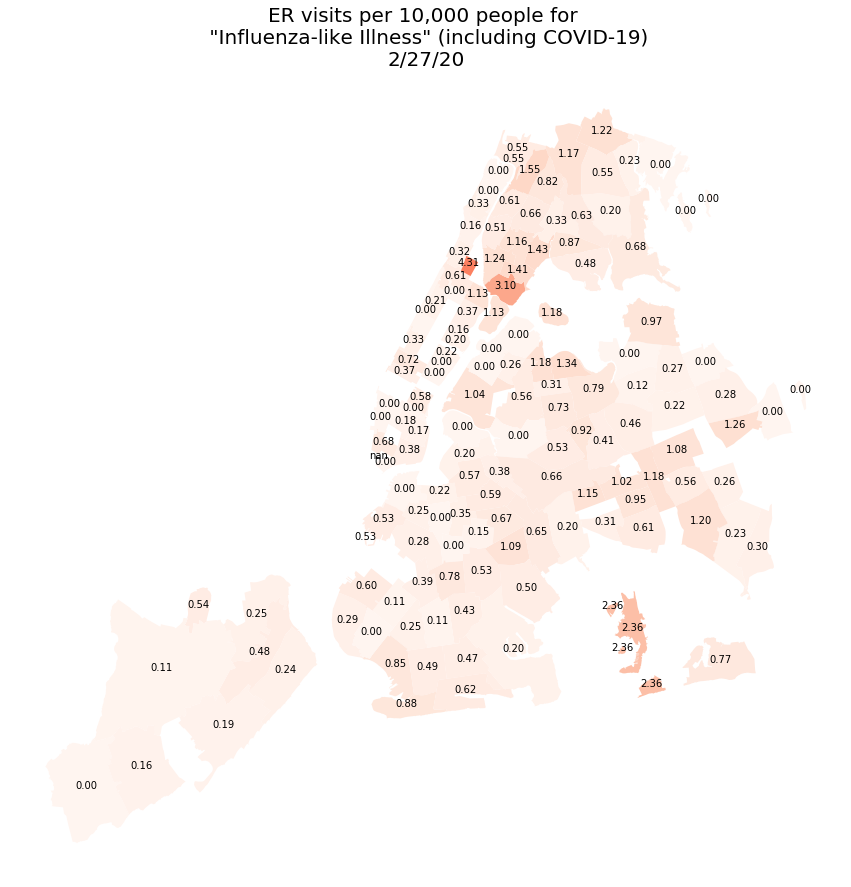

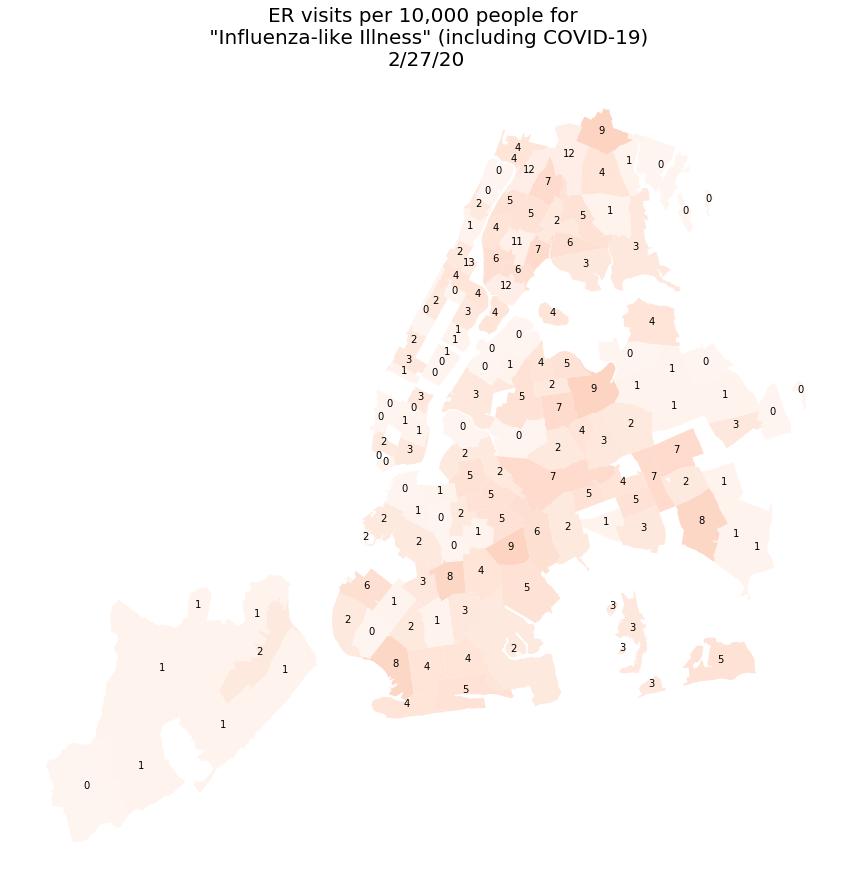

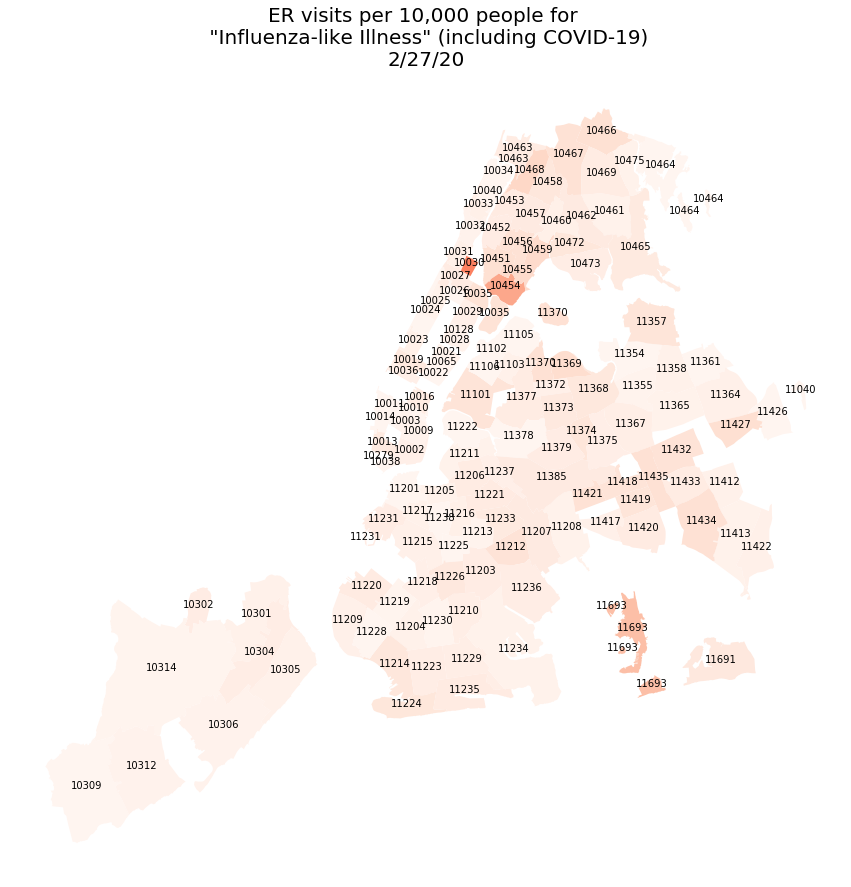

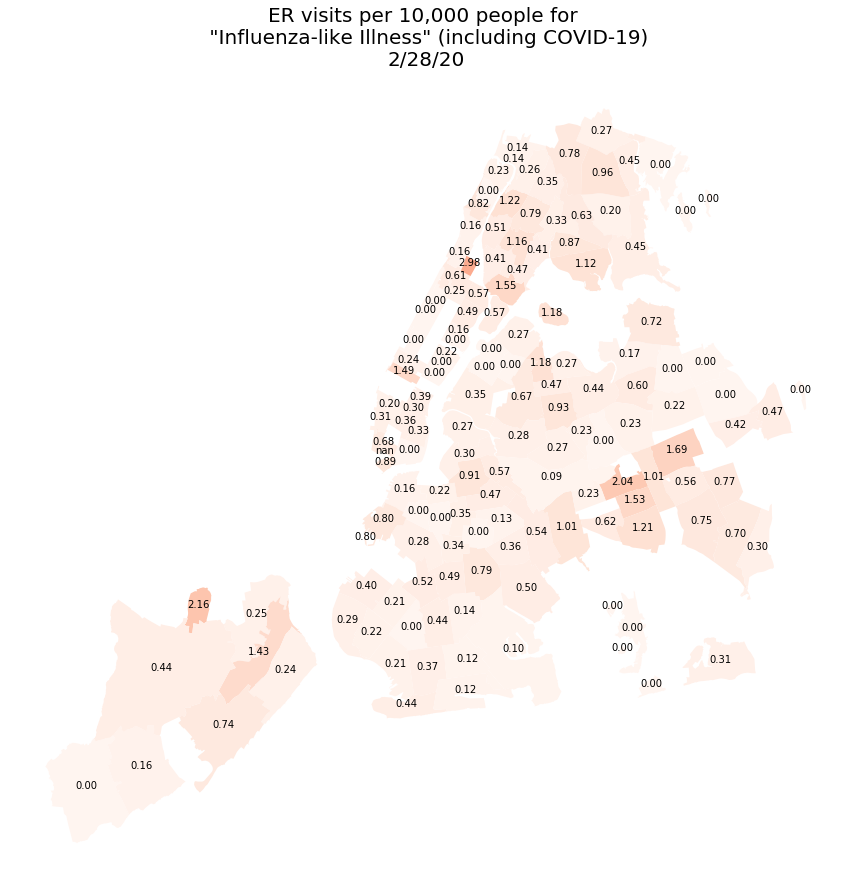

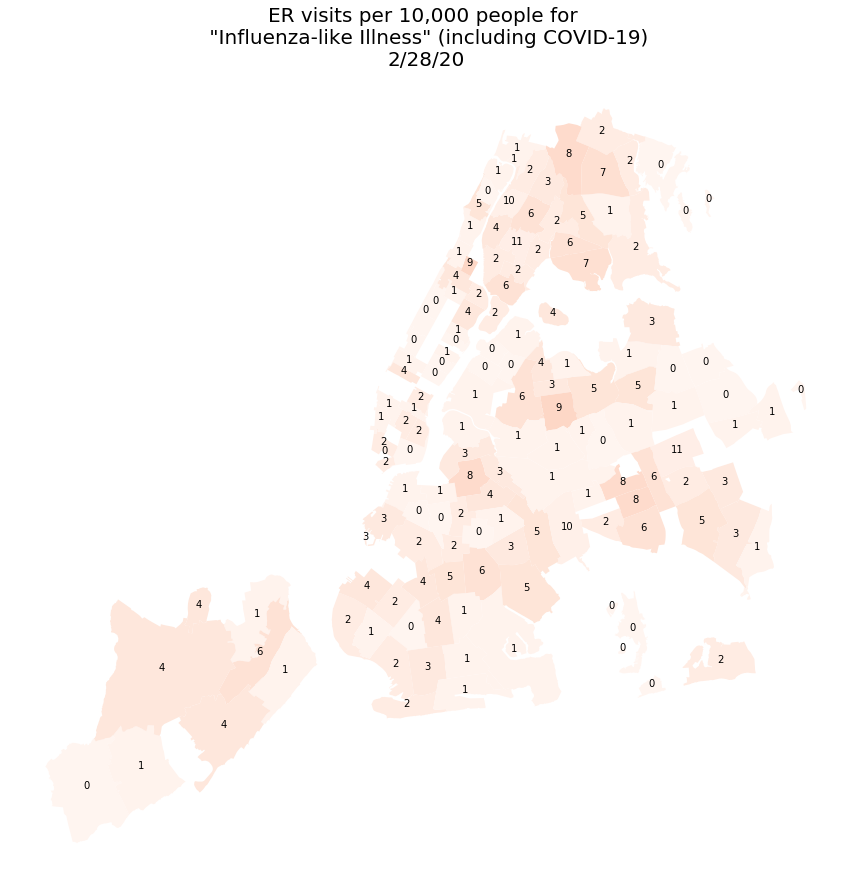

...

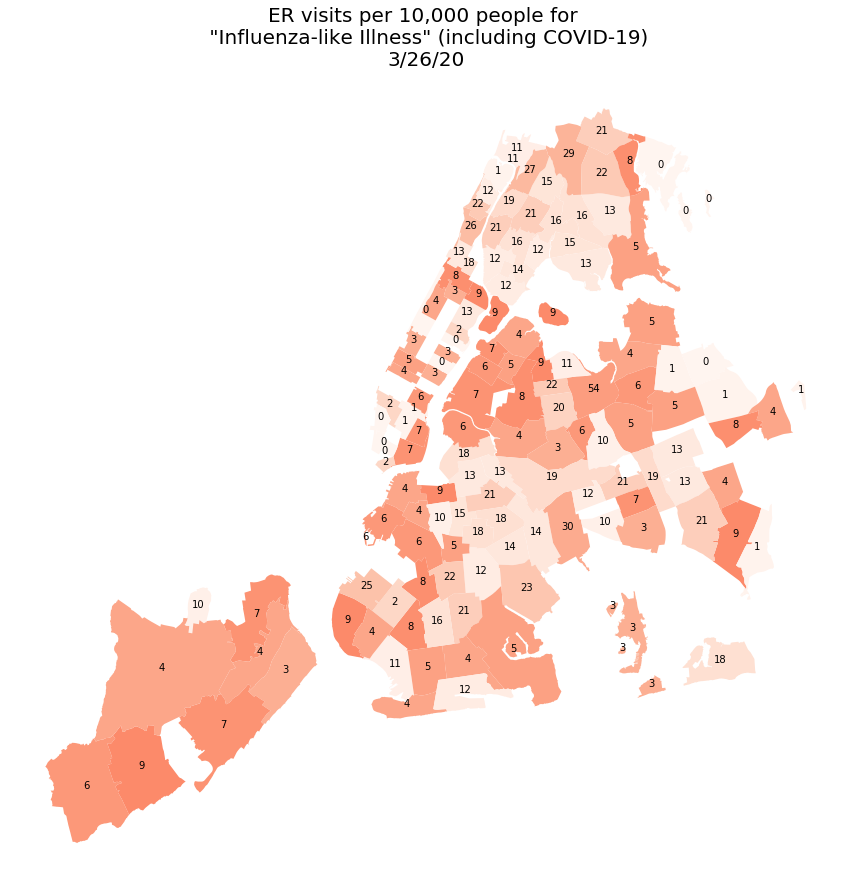

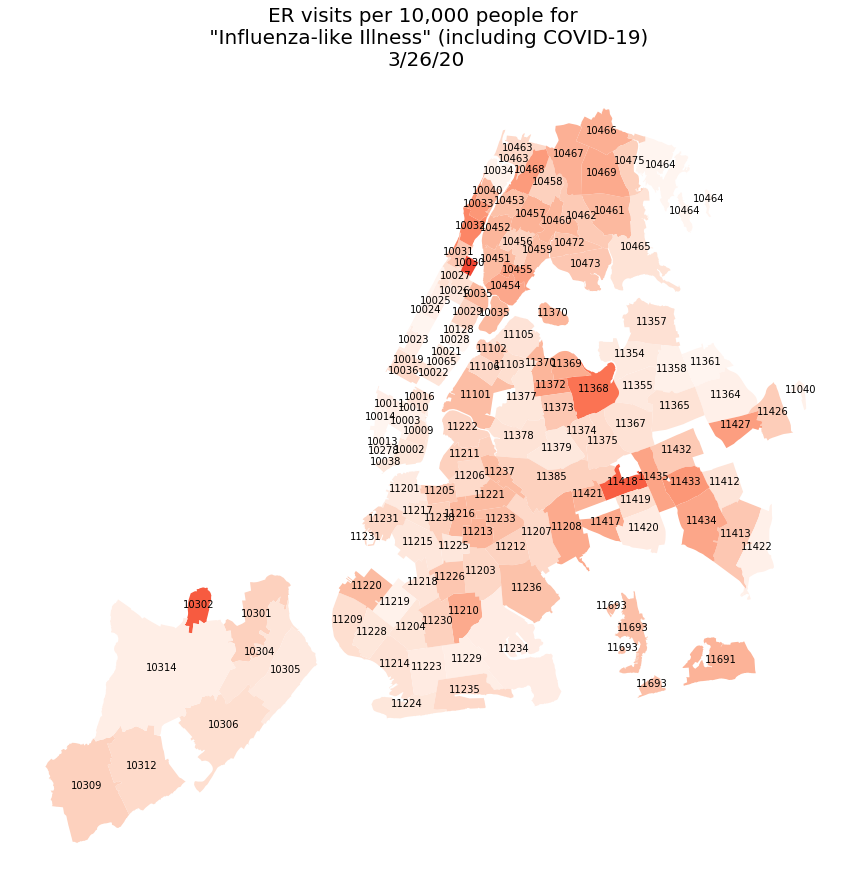

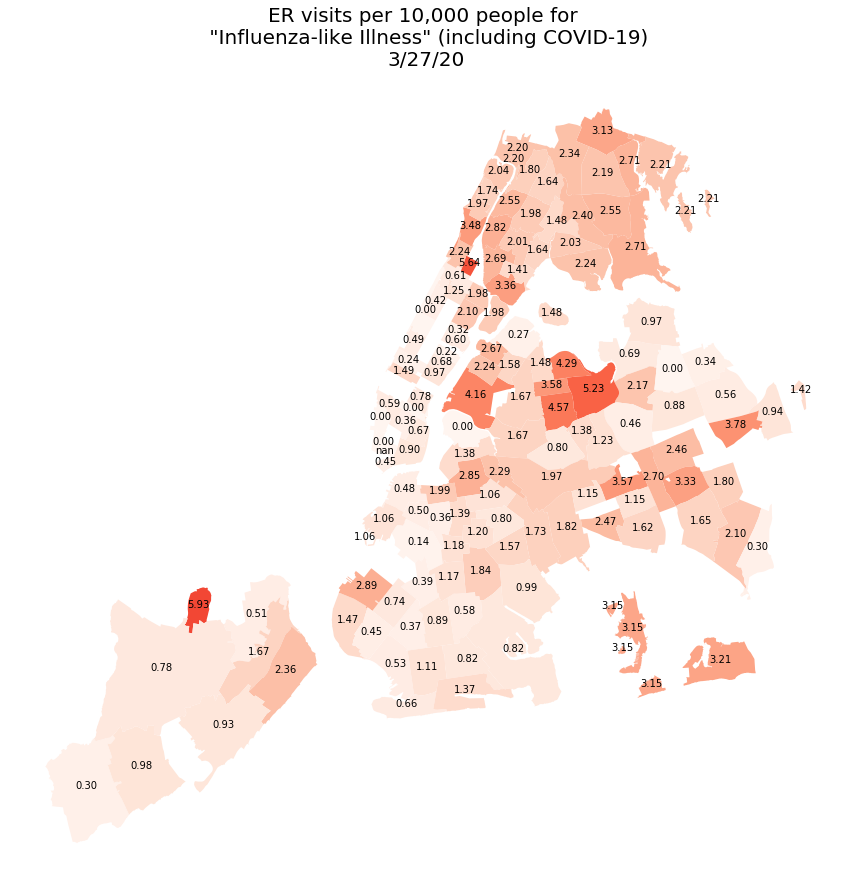

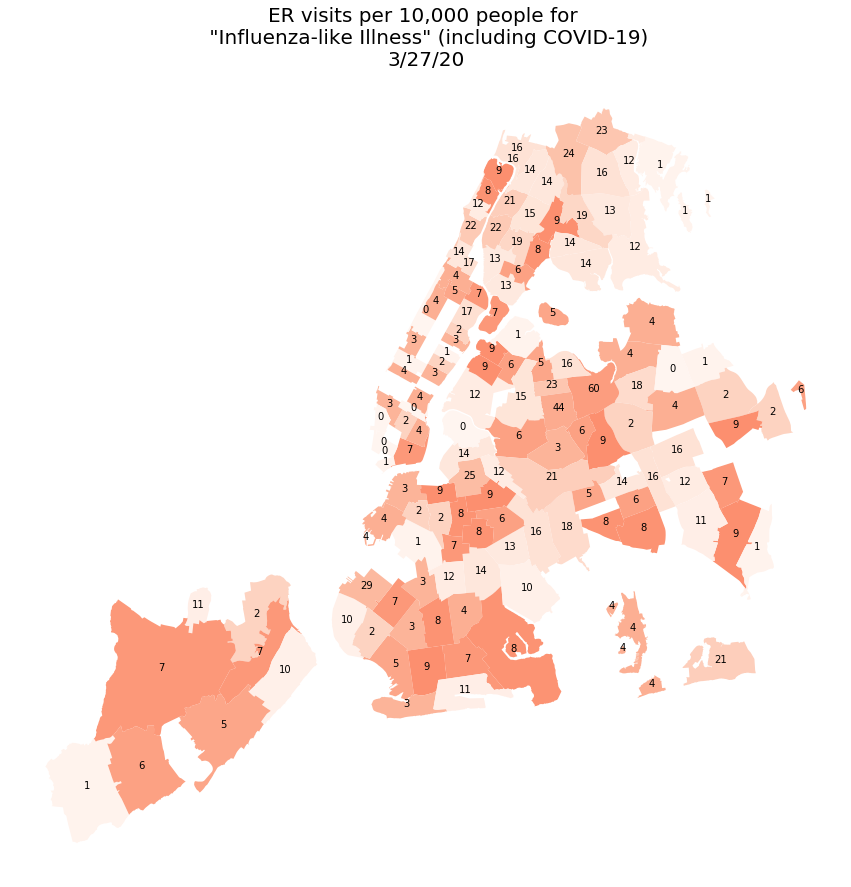

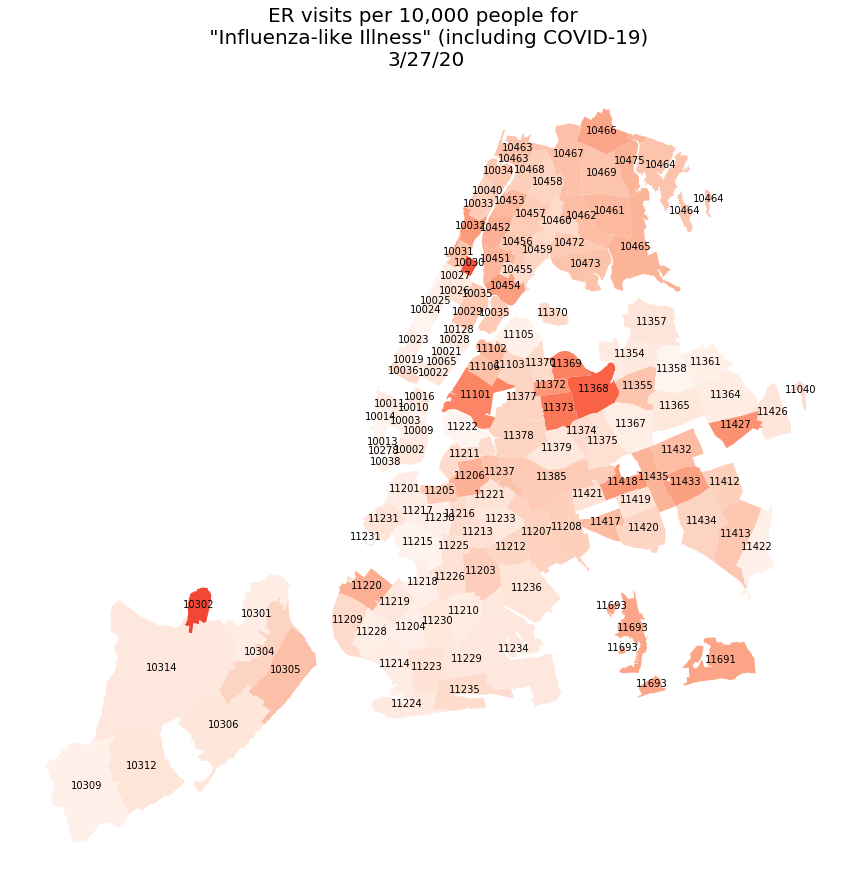

In [5523]:
infections = pd.read_csv('./ILI_data.csv')
infections.rename(columns=lambda x: x.strip(),inplace=True)
dates  = infections['Date'].unique()

for date in dates:
    
    print(date)
    
    #Import and clean
    infections = pd.read_csv('./ILI_data.csv')
    infections.rename(columns=lambda x: x.strip(),inplace=True)
    infections.reset_index()
    
    #Filter
    infections = infections[infections['Zip'] != 'Citywide']
    infections = infections[infections['Zip'] != 'Citwide']
    infections = infections[infections['Zip'].notnull()]
    infections = infections[infections['Dim2Value'] == 'All age groups']
    infections = infections[infections['Date'] == date]
    
    #Groupby
    infections = infections.reset_index()
    infections['Zip'] = infections['Zip'].astype(int)

    infections = infections.groupby(['Zip','Date','Count']).sum()
    infections = infections.reset_index()

    infections = GeoDataFrame(infections.merge(zip_codes, how='left', left_on='Zip', right_on='zip_code'))
    infections = infections[infections['geometry'].notnull()]
    
    #Add Zip Code Shapes
    zip_codes = GeoDataFrame.from_file('./ZIP_CODE_040114/ZIP_CODE_040114.shp') #read in shape file
    zip_codes['zip_code'] = zip_codes['ZIPCODE'].astype(int) #converting zipcode column to integer data type
    
    #Zip Code Population
    zip_pop = pd.read_csv('./ACS_17_5YR_B01003/ACS_17_5YR_B01003_with_ann.csv')
    zip_pop.rename(columns=lambda x: x.strip(),inplace=True)

    #zip_pop['GEO.display-label'][100][-5:]
    zip_pop = zip_pop[1:]
    zip_pop['zip'] = zip_pop['GEO.id2'].astype(int)
    zip_pop.rename(columns=lambda x: x.strip(),inplace=True)
    
    infections = GeoDataFrame(infections.merge(zip_pop, how='outer', left_on='Zip', right_on='zip'))
    infections = infections[infections['Count'].notnull()]
    infections = infections[infections['HD01_VD01'].notnull()]

    infections['rate'] = infections['Count'].astype(int)/infections['HD01_VD01'].astype(int)
    
    infections['rate_pretty'] = np.nan

    for i, row in infections.iterrows():
        infections['rate_pretty'].iloc[i] = "{:.2f}".format(infections['rate'].iloc[i]*10000)
    
    datetime = pd.to_datetime(date)
    datestring = datetime.strftime('%Y%m%d')
    
    #Rate maps annotated with pretty rate
    fig, ax = plt.subplots(figsize = (15,15))
    
    norm = mpl.colors.Normalize(vmin=0,vmax=0.001)
    
    infections.plot(column='rate', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

    ax.autoscale(False)

    infections.apply(lambda x: ax.annotate(s=x.rate_pretty, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

    plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date, size=20)
    plt.axis('off')    
    plt.savefig('./images/rate/rate_' + datestring +'.png')
    #plt.show()
    
    #Make count maps annotated by raw count
    fig, ax = plt.subplots(figsize = (15,15))
    
    norm = mpl.colors.Normalize(vmin=0,vmax=70)
    
    infections.plot(column='Count', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

    ax.autoscale(False)

    infections.apply(lambda x: ax.annotate(s=x.Count, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

    plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date, size=20)
    plt.axis('off')    
    plt.savefig('./images/counts/counts_' + datestring +'.png')
    #plt.show()
    
    #Make rate maps annotated by zip code only
    fig, ax = plt.subplots(figsize = (15,15))

    norm = mpl.colors.Normalize(vmin=0,vmax=0.001)
    infections.plot(column='rate', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

    ax.autoscale(False)

    infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

    plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date, size=20)
    plt.axis('off')    
    plt.savefig('./images/zips/zips_' + datestring +'.png')
    #plt.show()


# Make maps of 3 day mean

2/28/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


2/29/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/1/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/2/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/3/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/4/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


3/5/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:98: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWa

3/6/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/7/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/8/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/9/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/10/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/11/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/12/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/13/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/14/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/15/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/16/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/17/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/18/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/19/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/20/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/21/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/22/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/23/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/24/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/25/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

3/26/20


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:82: RuntimeWa

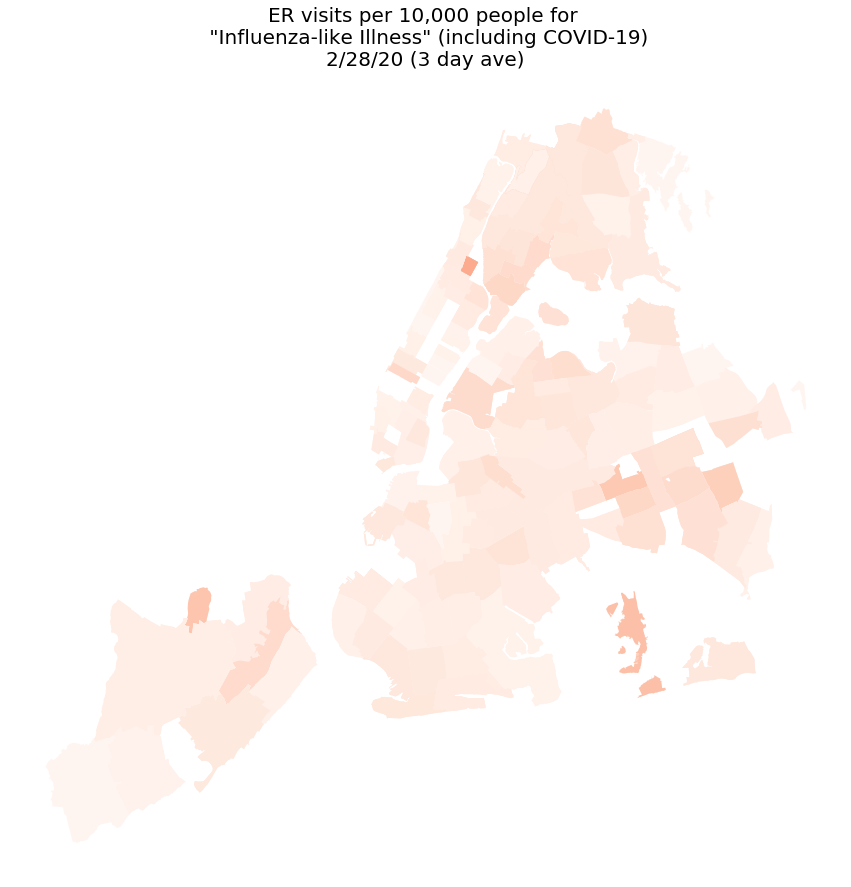

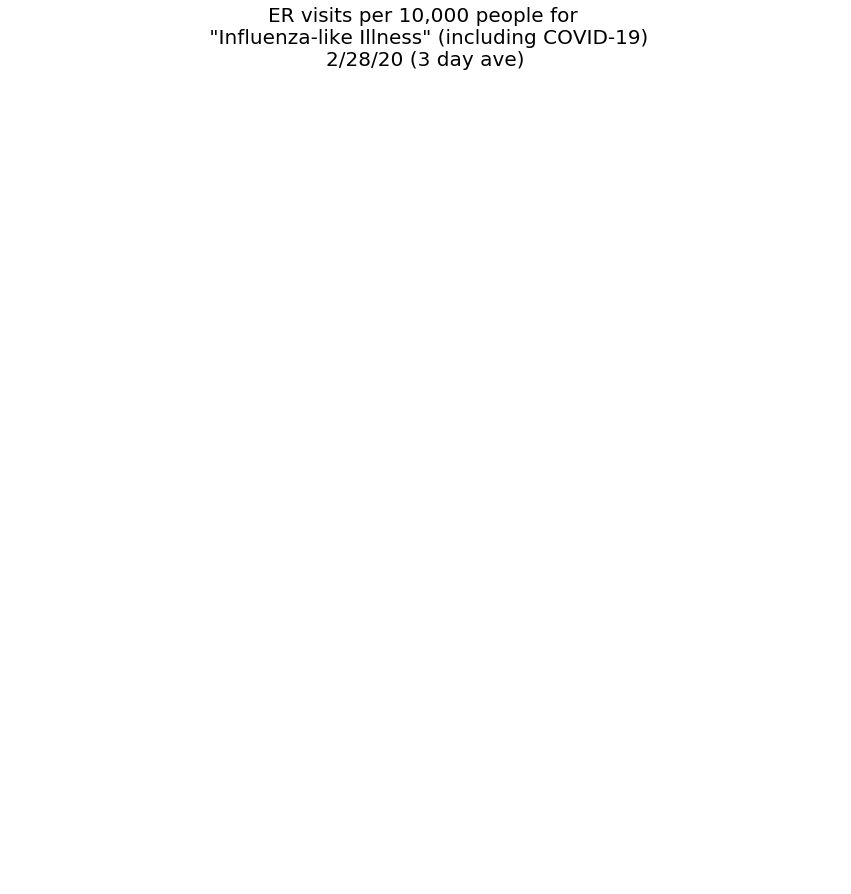

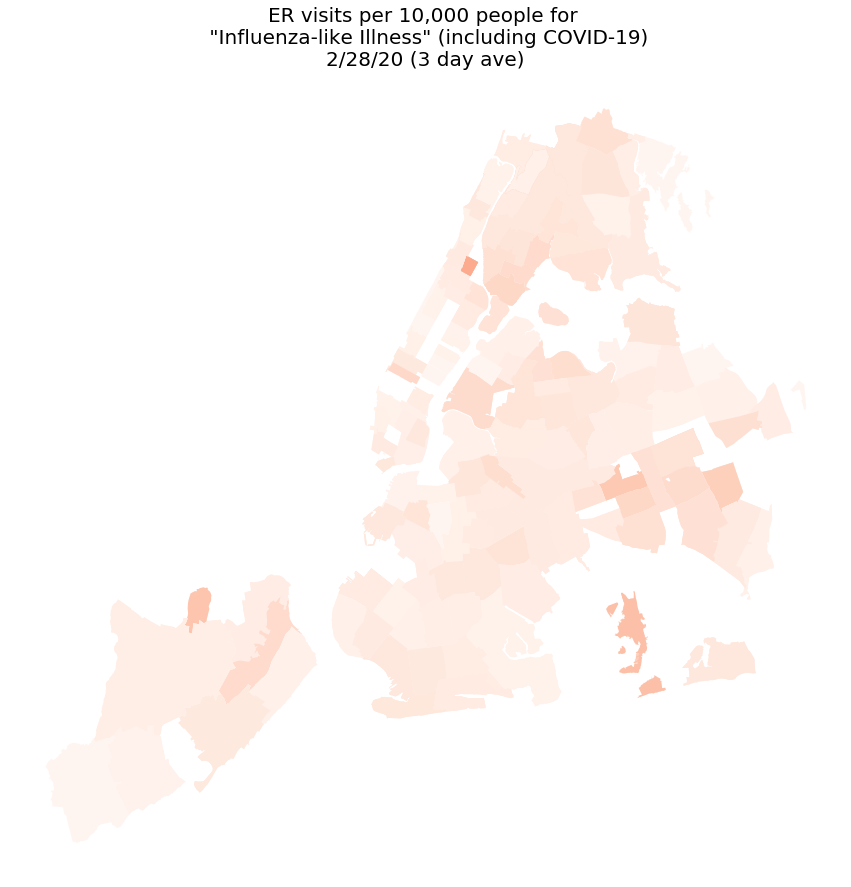

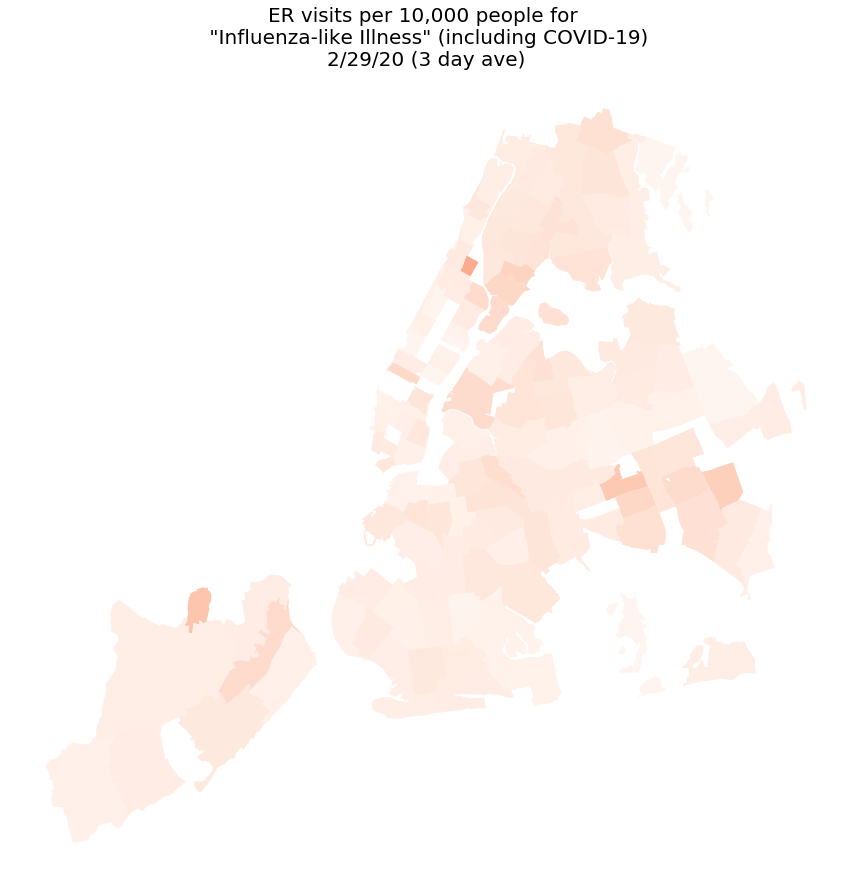

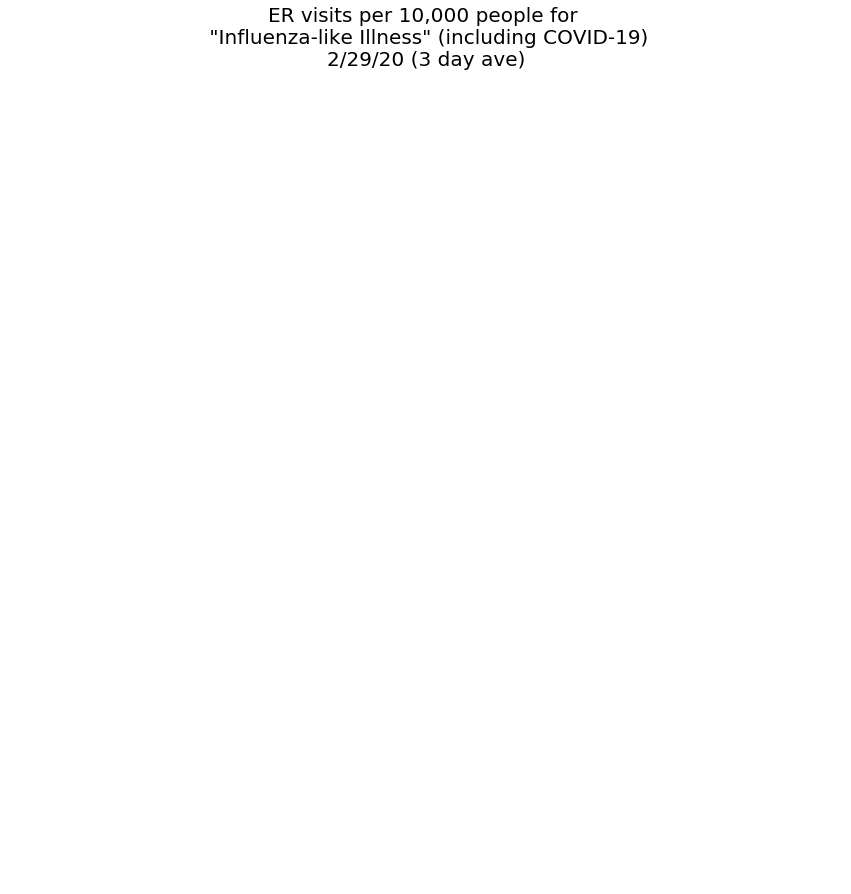

...

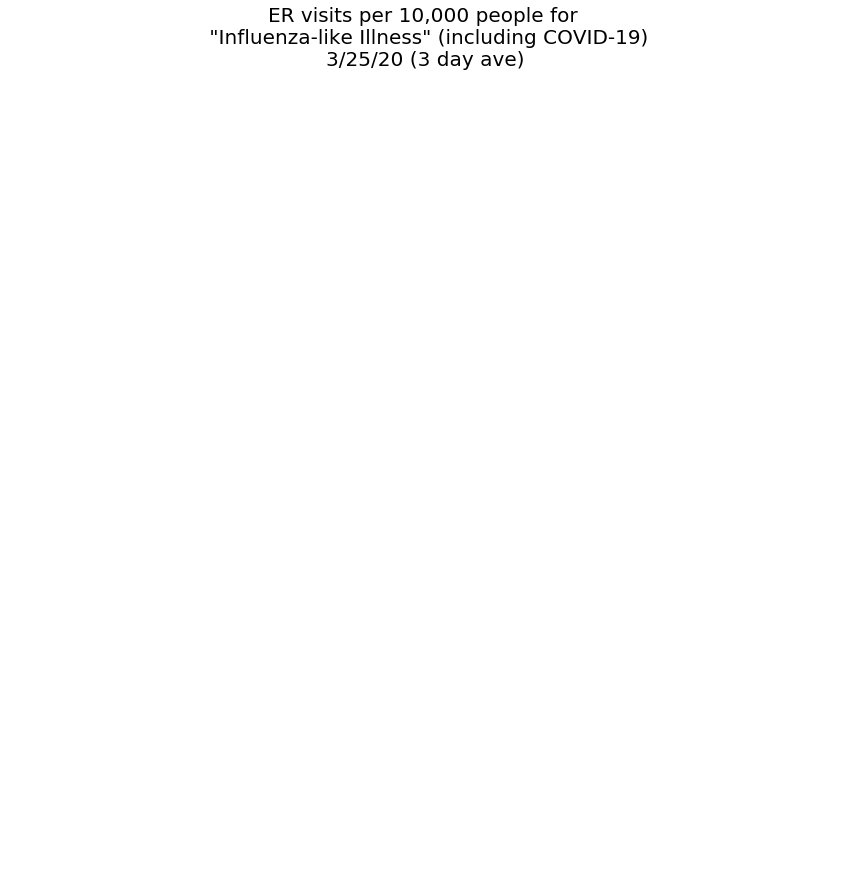

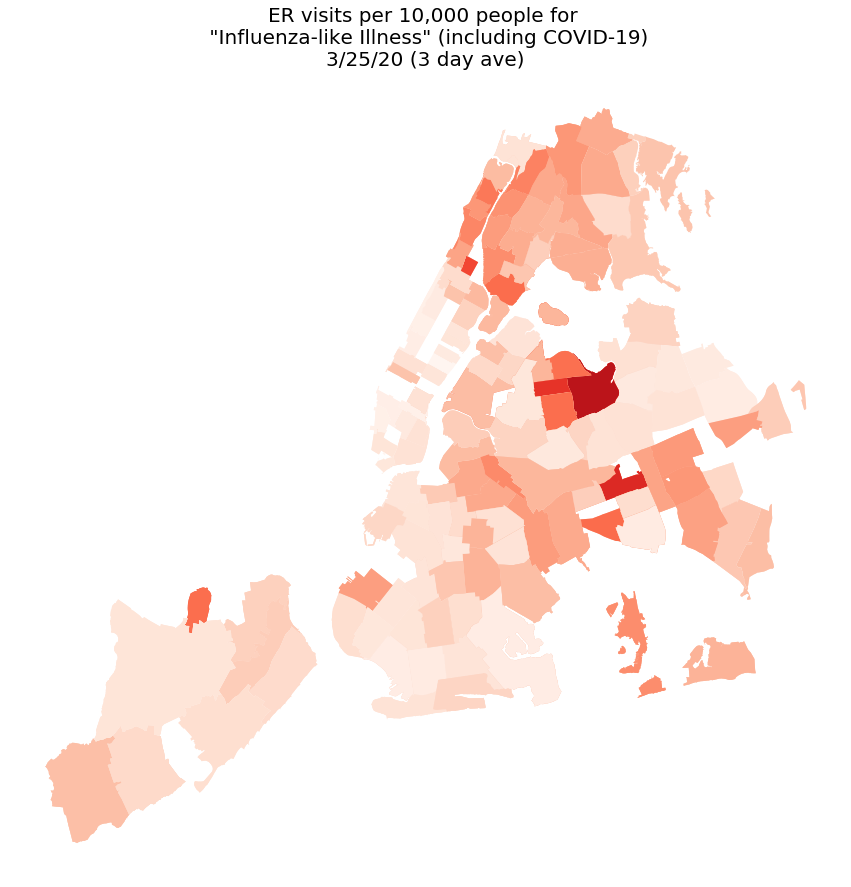

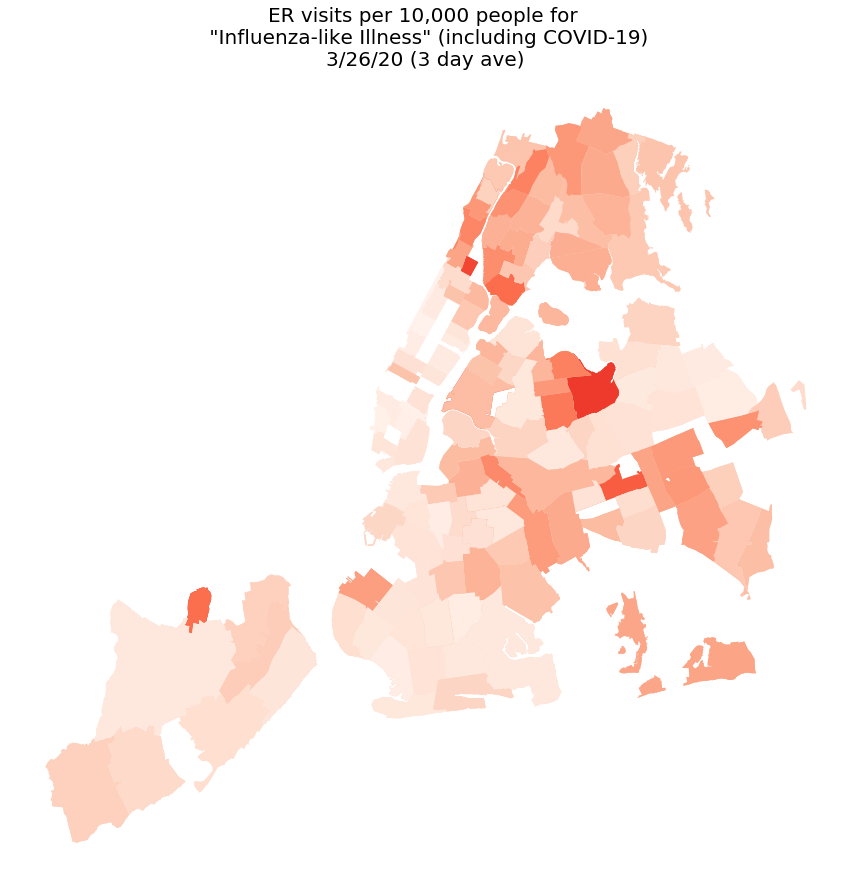

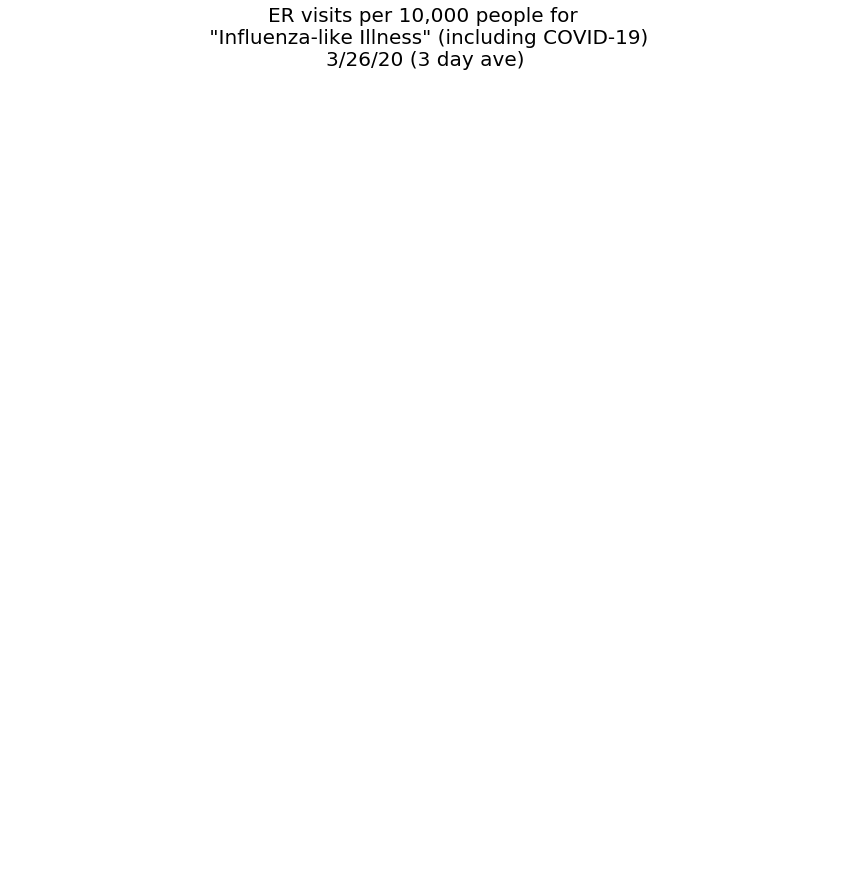

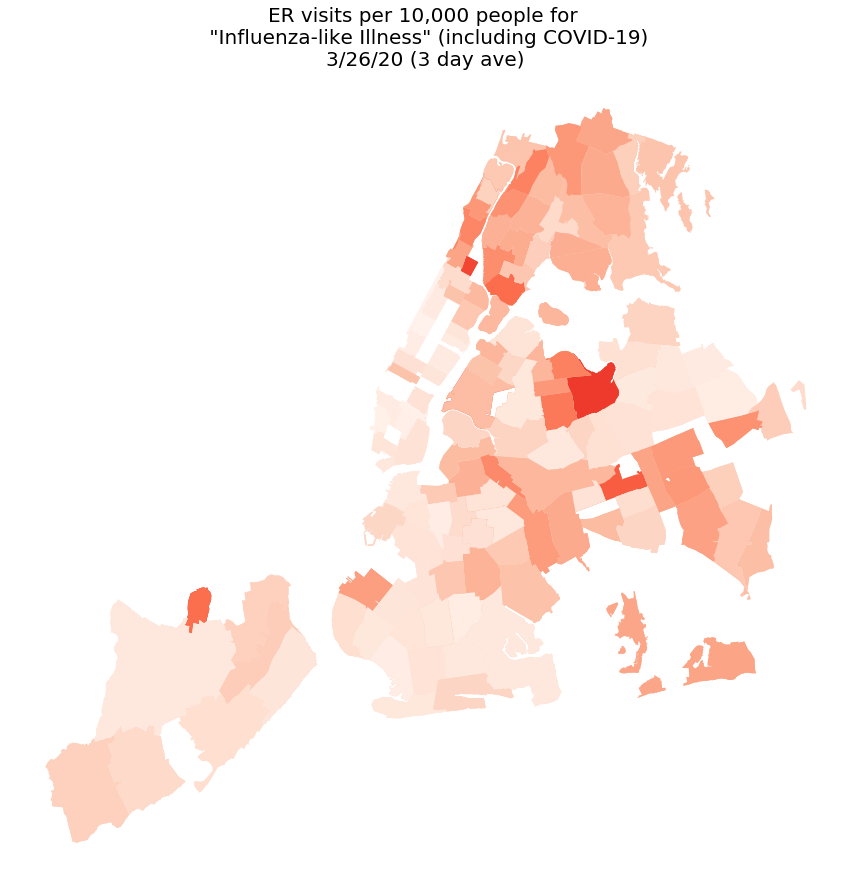

In [5566]:
infections = pd.read_csv('./ILI_data.csv')
infections.rename(columns=lambda x: x.strip(),inplace=True)
dates  = infections['Date'].unique()

for date in dates[1:-1]:
    datetime = pd.to_datetime(date)


    print(date)
    
    #Import and clean
    infections = pd.read_csv('./ILI_data.csv')
    infections.rename(columns=lambda x: x.strip(),inplace=True)
    infections.reset_index()
    
    df1 = infections[(infections['Date'] == (datetime - timedelta(days=1)).strftime('%-m/%-d/%y'))]
    df2 = infections[(infections['Date'] == date)]
    df3 = infections[(infections['Date'] == (datetime + timedelta(days=1)).strftime('%-m/%-d/%y'))]
    frames = [df1, df2, df3]
    infections = pd.concat(frames)
    
    #Filter
    infections = infections[infections['Zip'] != 'Citywide']
    infections = infections[infections['Zip'] != 'Citwide']
    infections = infections[infections['Zip'].notnull()]
    infections = infections[infections['Dim2Value'] == 'All age groups']
    
    #Groupby
    infections = infections.reset_index()
    infections['Zip'] = infections['Zip'].astype(int)

    infections = infections.groupby(['Zip','Count']).sum()
    infections = infections.reset_index()

    infections = GeoDataFrame(infections.merge(zip_codes, how='left', left_on='Zip', right_on='zip_code'))
    infections = infections[infections['geometry'].notnull()]
    
    #Add Zip Code Shapes
    zip_codes = GeoDataFrame.from_file('./ZIP_CODE_040114/ZIP_CODE_040114.shp') #read in shape file
    zip_codes['zip_code'] = zip_codes['ZIPCODE'].astype(int) #converting zipcode column to integer data type
    
    #Zip Code Population
    zip_pop = pd.read_csv('./ACS_17_5YR_B01003/ACS_17_5YR_B01003_with_ann.csv')
    zip_pop.rename(columns=lambda x: x.strip(),inplace=True)

    #zip_pop['GEO.display-label'][100][-5:]
    zip_pop = zip_pop[1:]
    zip_pop['zip'] = zip_pop['GEO.id2'].astype(int)
    zip_pop.rename(columns=lambda x: x.strip(),inplace=True)
    
    infections = GeoDataFrame(infections.merge(zip_pop, how='outer', left_on='Zip', right_on='zip'))
    infections = infections[infections['Count'].notnull()]
    infections = infections[infections['HD01_VD01'].notnull()]

    infections['rate'] = infections['Count'].astype(int)/infections['HD01_VD01'].astype(int)
    
    infections['rate_pretty'] = np.nan

    for i, row in infections.iterrows():
        infections['rate_pretty'].iloc[i] = "{:.2f}".format(infections['rate'].iloc[i]*10000)
    
    datetime = pd.to_datetime(date)
    datestring = datetime.strftime('%Y%m%d')
    
    #Rate maps annotated with pretty rate
    fig, ax = plt.subplots(figsize = (15,15))
    
    norm = mpl.colors.Normalize(vmin=0,vmax=0.001)
    
    infections.plot(column='rate', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

    ax.autoscale(False)

    #infections.apply(lambda x: ax.annotate(s=x.rate_pretty, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

    plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date + ' (3 day ave)', size=20)
    plt.axis('off')    
    plt.savefig('./images/rate3d/rate_' + datestring +'.png')
    #plt.show()
    
    #Make count maps annotated by raw count
    fig, ax = plt.subplots(figsize = (15,15))
    
    norm = mpl.colors.Normalize(vmin=0,vmax=70)
    
    #infections.plot(column='Count', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

    ax.autoscale(False)

    #infections.apply(lambda x: ax.annotate(s=x.Count, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

    plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date + ' (3 day ave)', size=20)
    plt.axis('off')    
    plt.savefig('./images/counts3d/counts_' + datestring +'.png')
    #plt.show()
    
    #Make rate maps annotated by zip code only
    fig, ax = plt.subplots(figsize = (15,15))

    norm = mpl.colors.Normalize(vmin=0,vmax=0.001)
    infections.plot(column='rate', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

    ax.autoscale(False)

    #infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

    plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date + ' (3 day ave)', size=20)
    plt.axis('off')    
    plt.savefig('./images/zips3d/zips_' + datestring +'.png')
    #plt.show()



# Animate

Use ImageMagik to make animated gifs on the command line with e.g.

convert rate_*.png nyc_map.gif

I added extra repeat frames at the beginning and end to give the viewer some time

# Old

Alternate method of clicking and saving data from the EpiQuery website used because it was easier for now

In [5554]:
infections = pd.read_csv('./ILI_data.csv')

In [5555]:
infections.rename(columns=lambda x: x.strip(),inplace=True)

In [5556]:
dates = infections['Date'].unique()

In [5557]:
dates

array(['2/27/20', '2/28/20', '2/29/20', '3/1/20', '3/2/20', '3/3/20',
       '3/4/20', '3/5/20', '3/6/20', '3/7/20', '3/8/20', '3/9/20',
       '3/10/20', '3/11/20', '3/12/20', '3/13/20', '3/14/20', '3/15/20',
       '3/16/20', '3/17/20', '3/18/20', '3/19/20', '3/20/20', '3/21/20',
       '3/22/20', '3/23/20', '3/24/20', '3/25/20', '3/26/20', '3/27/20'],
      dtype=object)

In [5558]:
infections[infections['Date'] ==(datetime - timedelta(days=1)).strftime('%-m/%-d/%y')]

,Dim1Name,Zip,Dim2Name,Dim2Value,Date,Count,Unnamed: 6
0,Citywide,Citwide,Age Group,All age groups,2/27/20,422,NaN
30,Citywide,Citwide,Age Group,Ages 0-4 years,2/27/20,99,NaN
60,Citywide,Citwide,Age Group,Ages 5-17 years,2/27/20,63,NaN
90,Citywide,Citwide,Age Group,Ages 18-64 years,2/27/20,226,NaN
120,Citywide,Citwide,Age Group,Ages 65+ years,2/27/20,34,NaN
...,...,...,...,...,...,...,...
20461,Zip,88888,Age Group,All age groups,2/27/20,0,NaN
20491,Zip,88888,Age Group,Ages 0-4 years,2/27/20,0,NaN
20521,Zip,88888,Age Group,Ages 5-17 years,2/27/20,0,NaN
20551,Zip,88888,Age Group,Ages 18-64 years,2/27/20,0,NaN


In [5560]:
for date in dates[1:-1]:
    #print(date)
    datetime = pd.to_datetime(date)
    #print(datetime)
    #print((datetime - timedelta(days=1)).strftime('%-m/%-d/%y'))
    infections = pd.read_csv('./ILI_data.csv')
    infections.rename(columns=lambda x: x.strip(),inplace=True)
    df1 = infections[(infections['Date'] == (datetime - timedelta(days=1)).strftime('%-m/%-d/%y'))]
    df2 = infections[(infections['Date'] == date)]
    df3 = infections[(infections['Date'] == (datetime + timedelta(days=1)).strftime('%-m/%-d/%y'))]
    frames = [df1, df2, df3]
    infections = pd.concat(frames)
    print(infections['Date'].unique())

['2/27/20' '2/28/20' '2/29/20']
['2/28/20' '2/29/20' '3/1/20']
['2/29/20' '3/1/20' '3/2/20']
['3/1/20' '3/2/20' '3/3/20']
['3/2/20' '3/3/20' '3/4/20']
['3/3/20' '3/4/20' '3/5/20']
['3/4/20' '3/5/20' '3/6/20']
['3/5/20' '3/6/20' '3/7/20']
['3/6/20' '3/7/20' '3/8/20']
['3/7/20' '3/8/20' '3/9/20']
['3/8/20' '3/9/20' '3/10/20']
['3/9/20' '3/10/20' '3/11/20']
['3/10/20' '3/11/20' '3/12/20']
['3/11/20' '3/12/20' '3/13/20']
['3/12/20' '3/13/20' '3/14/20']
['3/13/20' '3/14/20' '3/15/20']
['3/14/20' '3/15/20' '3/16/20']
['3/15/20' '3/16/20' '3/17/20']
['3/16/20' '3/17/20' '3/18/20']
['3/17/20' '3/18/20' '3/19/20']
['3/18/20' '3/19/20' '3/20/20']
['3/19/20' '3/20/20' '3/21/20']
['3/20/20' '3/21/20' '3/22/20']
['3/21/20' '3/22/20' '3/23/20']
['3/22/20' '3/23/20' '3/24/20']
['3/23/20' '3/24/20' '3/25/20']
['3/24/20' '3/25/20' '3/26/20']
['3/25/20' '3/26/20' '3/27/20']


,Dim1Name,Zip,Dim2Name,Dim2Value,Date,Count,Unnamed: 6


In [ ]:
datetime = pd.to_datetime(date)
datestring = datetime.strftime('%Y%m%d')

In [ ]:

infections = infections[infections['Date'] == date]

In [5460]:
date = '3/27/20'

In [5462]:
infections.reset_index()

,index,Dim1Name,Zip,Dim2Name,Dim2Value,Date,Count,Unnamed: 6
0,0,Citywide,Citwide,Age Group,All age groups,2/27/20,422,NaN
1,1,Citywide,Citwide,Age Group,All age groups,2/28/20,374,NaN
2,2,Citywide,Citwide,Age Group,All age groups,2/29/20,388,NaN
3,3,Citywide,Citwide,Age Group,All age groups,3/1/20,404,NaN
4,4,Citywide,Citwide,Age Group,All age groups,3/2/20,622,NaN
...,...,...,...,...,...,...,...,...
20606,20606,Zip,88888,Age Group,Ages 65+ years,3/23/20,0,NaN
20607,20607,Zip,88888,Age Group,Ages 65+ years,3/24/20,0,NaN
20608,20608,Zip,88888,Age Group,Ages 65+ years,3/25/20,0,NaN
20609,20609,Zip,88888,Age Group,Ages 65+ years,3/26/20,0,NaN


In [5464]:
infections = infections[infections['Zip'] != 'Citywide']
infections = infections[infections['Zip'] != 'Citwide']
infections = infections[infections['Zip'].notnull()]


infections = infections[infections['Dim2Value'] == 'All age groups']
infections = infections[infections['Date'] == date]

In [5465]:
infections.groupby(['Zip','Date','Count']).sum()

,,,Unnamed: 6
Zip,Date,Count,
10002,3/27/20,7,0.0
10003,3/27/20,2,0.0
10009,3/27/20,4,0.0
10010,3/27/20,0,0.0
10011,3/27/20,3,0.0
...,...,...,...
11434,3/27/20,11,0.0
11435,3/27/20,16,0.0
11691,3/27/20,21,0.0


In [5466]:
zip_codes = GeoDataFrame.from_file('./ZIP_CODE_040114/ZIP_CODE_040114.shp')

In [5467]:
zip_codes['zip_code'] = zip_codes['ZIPCODE'].astype(int)

In [5468]:
infections['Zip'] = infections['Zip'].astype(int)

In [5469]:
infections = infections.groupby(['Zip','Date','Count']).sum()

In [5470]:
infections = infections.reset_index()

In [5471]:
infections

,Zip,Date,Count,Unnamed: 6
0,10002,3/27/20,7,0.0
1,10003,3/27/20,2,0.0
2,10009,3/27/20,4,0.0
3,10010,3/27/20,0,0.0
4,10011,3/27/20,3,0.0
...,...,...,...,...
133,11434,3/27/20,11,0.0
134,11435,3/27/20,16,0.0
135,11691,3/27/20,21,0.0
136,11693,3/27/20,4,0.0


In [5472]:
zip_codes

,ZIPCODE,BLDGZIP,PO_NAME,POPULATION,AREA,STATE,COUNTY,ST_FIPS,CTY_FIPS,URL,SHAPE_AREA,SHAPE_LEN,geometry,zip_code
0,11436,0,Jamaica,18681.0,2.269930e+07,NY,Queens,36,081,http://www.usps.com/,0.0,0.0,"POLYGON ((1038098.252 188138.380, 1038141.936 ...",11436
1,11213,0,Brooklyn,62426.0,2.963100e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((1001613.713 186926.440, 1002314.243 ...",11213
2,11212,0,Brooklyn,83866.0,4.197210e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((1011174.276 183696.338, 1011373.584 ...",11212
3,11225,0,Brooklyn,56527.0,2.369863e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((995908.365 183617.613, 996522.848 18...",11225
4,11218,0,Brooklyn,72280.0,3.686880e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((991997.113 176307.496, 992042.798 17...",11218
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
258,10310,0,Staten Island,25003.0,5.346328e+07,NY,Richmond,36,085,http://www.usps.com/,0.0,0.0,"POLYGON ((950767.507 172848.969, 950787.510 17...",10310
259,11693,0,Far Rockaway,11052.0,3.497516e+06,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((1028453.995 167153.410, 1027813.010 ...",11693
260,11249,0,Brooklyn,28481.0,1.777221e+07,NY,Kings,36,047,http://www.usps.com/,0.0,0.0,"POLYGON ((995877.318 203206.075, 995968.511 20...",11249
261,10162,1,New York,0.0,2.103489e+04,NY,New York,36,061,http://www.usps.com/,0.0,0.0,"POLYGON ((997731.761 219560.922, 997641.948 21...",10162


In [5473]:
infections = GeoDataFrame(infections.merge(zip_codes, how='left', left_on='Zip', right_on='zip_code'))

In [5474]:
infections = infections[infections['geometry'].notnull()]

In [5475]:
infections[['Zip','zip_code','Count']].head(30)

,Zip,zip_code,Count
0,10002,10002.0,7
1,10003,10003.0,2
2,10009,10009.0,4
3,10010,10010.0,0
4,10011,10011.0,3
5,10013,10013.0,0
6,10014,10014.0,0
7,10016,10016.0,4
8,10019,10019.0,1
9,10021,10021.0,1


In [5476]:
infections['Zip'] = infections['Zip'].astype(int)

In [5477]:
zip_pop = pd.read_csv('./ACS_17_5YR_B01003/ACS_17_5YR_B01003_with_ann.csv')

In [5478]:
zip_pop['GEO.display-label'][100][-5:]

'00917'

In [5479]:
zip_pop = zip_pop[1:]

In [5480]:
zip_pop['zip'] = zip_pop['GEO.id2'].astype(int)

In [5481]:
zip_pop

,GEO.id,GEO.id2,GEO.display-label,HD01_VD01,HD02_VD01,zip
1,1600000US3651000,3651000,"New York city, New York",8560072,*****,3651000
2,8600000US00601,00601,ZCTA5 00601,17599,261,601
3,8600000US00602,00602,ZCTA5 00602,39209,128,602
4,8600000US00603,00603,ZCTA5 00603,50135,805,603
5,8600000US00606,00606,ZCTA5 00606,6304,255,606
...,...,...,...,...,...,...
33117,8600000US99923,99923,ZCTA5 99923,0,9,99923
33118,8600000US99925,99925,ZCTA5 99925,901,107,99925
33119,8600000US99926,99926,ZCTA5 99926,1684,117,99926
33120,8600000US99927,99927,ZCTA5 99927,59,40,99927


In [5482]:
zip_pop.rename(columns=lambda x: x.strip(),inplace=True)

In [5483]:
infections = GeoDataFrame(infections.merge(zip_pop, how='outer', left_on='Zip', right_on='zip'))

In [5484]:
infections['HD01_VD01']

0        77925
1        55035
2        60141
3        33119
4        50711
         ...  
33125        0
33126      901
33127     1684
33128       59
33129     2455
Name: HD01_VD01, Length: 33130, dtype: object

In [5485]:
infections = infections[infections['Count'].notnull()]

In [5486]:
list(infections.columns)

['Zip',
 'Date',
 'Count',
 'Unnamed: 6',
 'ZIPCODE',
 'BLDGZIP',
 'PO_NAME',
 'POPULATION',
 'AREA',
 'STATE',
 'COUNTY',
 'ST_FIPS',
 'CTY_FIPS',
 'URL',
 'SHAPE_AREA',
 'SHAPE_LEN',
 'geometry',
 'zip_code',
 'GEO.id',
 'GEO.id2',
 'GEO.display-label',
 'HD01_VD01',
 'HD02_VD01',
 'zip']

In [5487]:
list(infections.ix[3])

/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  """Entry point for launching an IPython kernel.


[10010.0,
 '3/27/20',
 '0',
 0.0,
 '10010',
 '0',
 'New York',
 29881.0,
 9768395.56994528,
 'NY',
 'New York',
 '36',
 '061',
 'http://www.usps.com/',
 0.0,
 0.0,
 10010.0,
 '8600000US10010',
 '10010',
 'ZCTA5 10010',
 '33119',
 '2073',
 10010]

In [5488]:
infections['rate'] = infections['Count'].astype(int)/infections['POPULATION'].astype(int)

In [5489]:
infections[infections['rate'] == max(infections['rate'])]

,Zip,Date,Count,Unnamed: 6,ZIPCODE,BLDGZIP,PO_NAME,POPULATION,AREA,STATE,...,SHAPE_LEN,geometry,zip_code,GEO.id,GEO.id2,GEO.display-label,HD01_VD01,HD02_VD01,zip,rate
64,11040.0,3/27/20,6,0.0,11040,0,New Hyde Park,2349.0,6.269333e+06,NY,...,0.0,"POLYGON ((1067113.207 208617.543, 1066921.908 ...",11040.0,8600000US11040,11040,ZCTA5 11040,42140,876,11040,0.002554


In [5490]:
(infections['rate']*infections['POPULATION'].astype(int))-infections['Count'].astype(int)

0      0.000000e+00
1     -2.220446e-16
2      0.000000e+00
3      0.000000e+00
4      0.000000e+00
           ...     
140    0.000000e+00
141    0.000000e+00
142    0.000000e+00
143    0.000000e+00
144    0.000000e+00
Length: 145, dtype: float64

In [5491]:
infections['rate'].describe()

count    144.000000
mean       0.000191
std        0.000234
min        0.000000
25%        0.000072
50%        0.000158
75%        0.000241
max        0.002554
Name: rate, dtype: float64

In [5492]:
infections['rate_pretty'] = np.nan

for i, row in infections.iterrows():
        infections['rate_pretty'].iloc[i] = "{:.2f}".format(infections['rate'].iloc[i]*10000)

/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/pandas/core/indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


In [5493]:
infections

,Zip,Date,Count,Unnamed: 6,ZIPCODE,BLDGZIP,PO_NAME,POPULATION,AREA,STATE,...,geometry,zip_code,GEO.id,GEO.id2,GEO.display-label,HD01_VD01,HD02_VD01,zip,rate,rate_pretty
0,10002.0,3/27/20,7,0.0,10002,0,New York,81305.0,2.628013e+07,NY,...,"POLYGON ((991339.870 207576.784, 991330.490 20...",10002.0,8600000US10002,10002,ZCTA5 10002,77925,2031,10002,0.000086,0.86
1,10003.0,3/27/20,2,0.0,10003,0,New York,55878.0,1.553838e+07,NY,...,"POLYGON ((989830.469 207048.126, 989716.354 20...",10003.0,8600000US10003,10003,ZCTA5 10003,55035,1789,10003,0.000036,0.36
2,10009.0,3/27/20,4,0.0,10009,0,New York,61455.0,1.590352e+07,NY,...,"POLYGON ((991606.403 205494.146, 991619.927 20...",10009.0,8600000US10009,10009,ZCTA5 10009,60141,1585,10009,0.000065,0.65
3,10010.0,3/27/20,0,0.0,10010,0,New York,29881.0,9.768396e+06,NY,...,"POLYGON ((987500.000 210146.438, 987521.554 21...",10010.0,8600000US10010,10010,ZCTA5 10010,33119,2073,10010,0.000000,0.00
4,10011.0,3/27/20,3,0.0,10011,0,New York,50594.0,1.811842e+07,NY,...,"POLYGON ((986378.434 210178.599, 986279.129 20...",10011.0,8600000US10011,10011,ZCTA5 10011,50711,1638,10011,0.000059,0.59
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140,11691.0,3/27/20,21,0.0,11691,0,Far Rockaway,60267.0,8.392782e+07,NY,...,"POLYGON ((1054519.888 162245.759, 1054622.095 ...",11691.0,8600000US11691,11691,ZCTA5 11691,65356,2539,11691,0.000348,3.48
141,11693.0,3/27/20,4,0.0,11693,0,Far Rockaway,11052.0,4.647173e+07,NY,...,"POLYGON ((1030865.641 170727.666, 1030861.340 ...",11693.0,8600000US11693,11693,ZCTA5 11693,12709,1296,11693,0.000362,3.62
142,11693.0,3/27/20,4,0.0,11693,0,Far Rockaway,11052.0,1.527599e+06,NY,...,"POLYGON ((1030722.649 160980.770, 1030642.283 ...",11693.0,8600000US11693,11693,ZCTA5 11693,12709,1296,11693,0.000362,3.62
143,11693.0,3/27/20,4,0.0,11693,0,Far Rockaway,11052.0,1.227092e+07,NY,...,"POLYGON ((1036087.150 154632.639, 1036096.661 ...",11693.0,8600000US11693,11693,ZCTA5 11693,12709,1296,11693,0.000362,3.62


In [5494]:
datetime = pd.to_datetime(date)
datestring = datetime.strftime('%Y%m%d')

/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


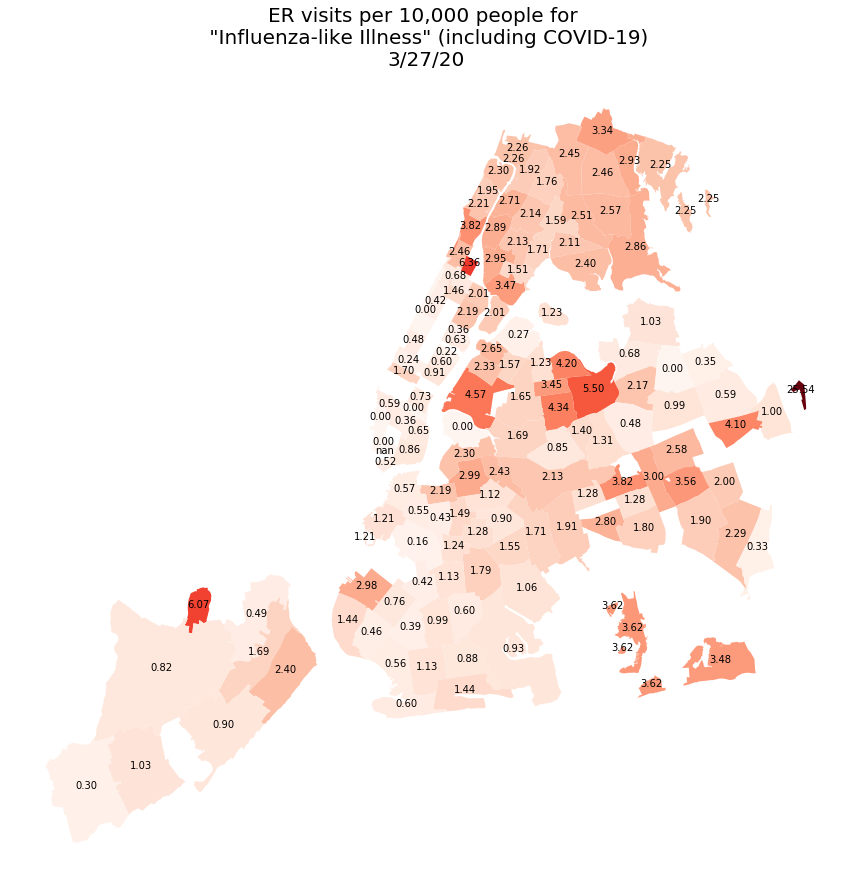

In [5495]:
#Plotting the data
fig, ax = plt.subplots(figsize = (15,15))

#norm = colors.Normalize(vmin=0,vmax=0.001)
norm = mpl.colors.Normalize(vmin=0,vmax=0.001)
infections.plot(column='rate', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

ax.autoscale(False)

#infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='right'),axis=1);
#infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

#infections.apply(lambda x: ax.annotate(s=x.Count, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);
infections.apply(lambda x: ax.annotate(s=x.rate_pretty, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);
#infections.apply(lambda x: ax.annotate(s=x.PO_NAME, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date, size=20)
plt.axis('off')    
plt.savefig('./images/' + datestring +'.png')
plt.show()


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


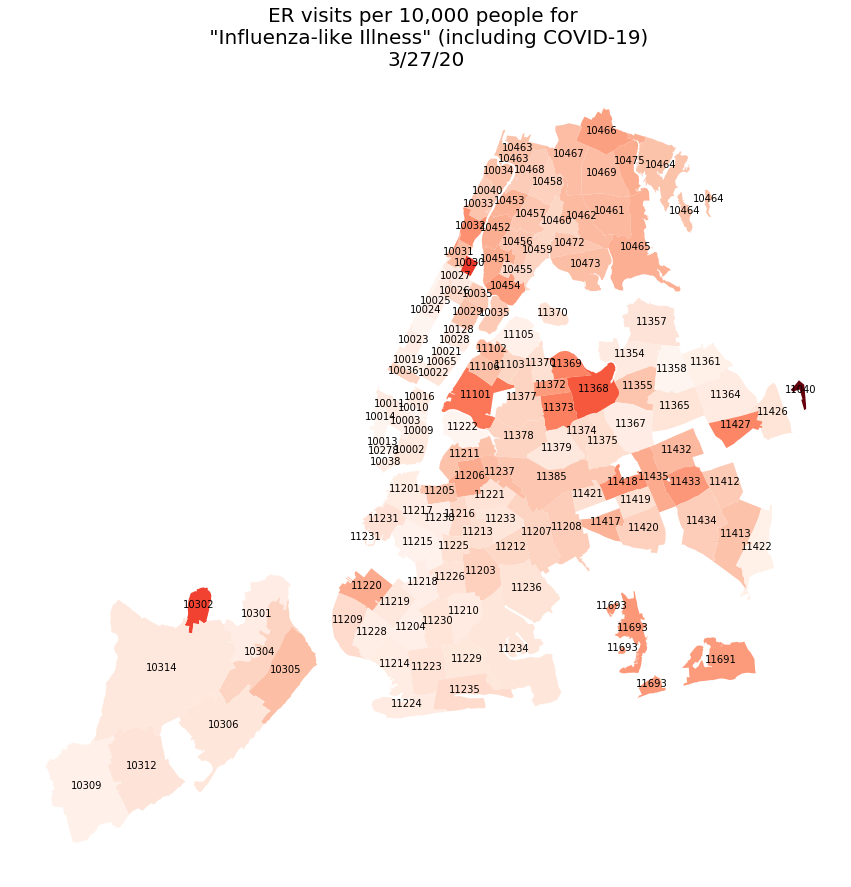

In [5498]:
#Plotting the data
fig, ax = plt.subplots(figsize = (15,15))

#norm = colors.Normalize(vmin=0,vmax=0.001)
norm = mpl.colors.Normalize(vmin=0,vmax=0.001)
infections.plot(column='rate', cmap='Reds', norm=norm, alpha=1, linewidth=0.1, ax=ax)

ax.autoscale(False)

#infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='right'),axis=1);
infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

#infections.apply(lambda x: ax.annotate(s=x.Count, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);
#infections.apply(lambda x: ax.annotate(s=x.rate_pretty, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);
#infections.apply(lambda x: ax.annotate(s=x.PO_NAME, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

plt.title('ER visits per 10,000 people for \n "Influenza-like Illness" (including COVID-19)\n' + date, size=20)
plt.axis('off')    
plt.savefig('./images/rate/zips_' + datestring +'.png')
plt.show()


/Users/janagrc/.pyenv/versions/jupyter3/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


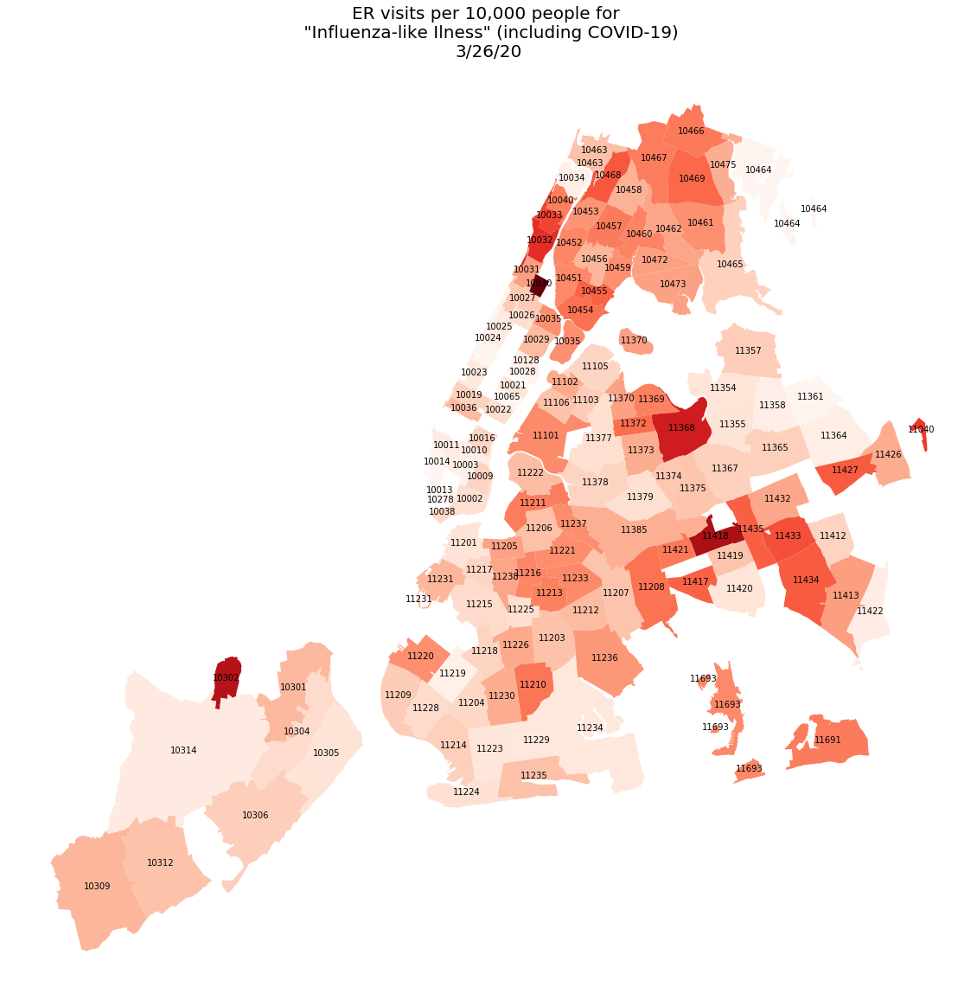

<Figure size 432x288 with 0 Axes>

In [5458]:
#Plotting the data
fig, ax = plt.subplots(figsize = (20,20))

#norm = colors.Normalize(vmin=0,vmax=0.001)
norm = mpl.colors.Normalize(vmin=0,vmax=0.0001)
infections.plot(column='change', cmap='Reds', alpha=1, linewidth=0.1, ax=ax)

#infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='right'),axis=1);
infections.apply(lambda x: ax.annotate(s=x.zip, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

#infections.apply(lambda x: ax.annotate(s=x.Count, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);
#infections.apply(lambda x: ax.annotate(s=x.rate_pretty, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);
#infections.apply(lambda x: ax.annotate(s=x.PO_NAME, xy=x.geometry.centroid.coords[0], ha='center'),axis=1);

plt.title('ER visits per 10,000 people for \n "Influenza-like Ilness" (including COVID-19)\n' + date, size=20)
plt.axis('off')
plt.show()
    
plt.savefig('./images/'+ date.replace('/','_') + '1d_change' + '.png')

In [3835]:
infections

,Zip,Date,Count,Unnamed: 6,ZIPCODE,BLDGZIP,PO_NAME,POPULATION,AREA,STATE,...,geometry,zip_code,GEO.id,GEO.id2,GEO.display-label,HD01_VD01,HD02_VD01,zip,rate,rate_pretty
0,10002.0,3/12/20,10,0.0,10002,0,New York,81305.0,2.628013e+07,NY,...,"POLYGON ((991339.870 207576.784, 991330.490 20...",10002.0,8600000US10002,10002,ZCTA5 10002,77925,2031,10002,0.000123,1.23
1,10003.0,3/12/20,1,0.0,10003,0,New York,55878.0,1.553838e+07,NY,...,"POLYGON ((989830.469 207048.126, 989716.354 20...",10003.0,8600000US10003,10003,ZCTA5 10003,55035,1789,10003,0.000018,0.18
2,10009.0,3/12/20,9,0.0,10009,0,New York,61455.0,1.590352e+07,NY,...,"POLYGON ((991606.403 205494.146, 991619.927 20...",10009.0,8600000US10009,10009,ZCTA5 10009,60141,1585,10009,0.000146,1.46
3,10010.0,3/12/20,2,0.0,10010,0,New York,29881.0,9.768396e+06,NY,...,"POLYGON ((987500.000 210146.438, 987521.554 21...",10010.0,8600000US10010,10010,ZCTA5 10010,33119,2073,10010,0.000067,0.67
4,10011.0,3/12/20,6,0.0,10011,0,New York,50594.0,1.811842e+07,NY,...,"POLYGON ((986378.434 210178.599, 986279.129 20...",10011.0,8600000US10011,10011,ZCTA5 10011,50711,1638,10011,0.000119,1.19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,11691.0,3/12/20,14,0.0,11691,0,Far Rockaway,60267.0,8.392782e+07,NY,...,"POLYGON ((1054519.888 162245.759, 1054622.095 ...",11691.0,8600000US11691,11691,ZCTA5 11691,65356,2539,11691,0.000232,2.32
143,11693.0,3/12/20,1,0.0,11693,0,Far Rockaway,11052.0,4.647173e+07,NY,...,"POLYGON ((1030865.641 170727.666, 1030861.340 ...",11693.0,8600000US11693,11693,ZCTA5 11693,12709,1296,11693,0.000090,0.90
144,11693.0,3/12/20,1,0.0,11693,0,Far Rockaway,11052.0,1.527599e+06,NY,...,"POLYGON ((1030722.649 160980.770, 1030642.283 ...",11693.0,8600000US11693,11693,ZCTA5 11693,12709,1296,11693,0.000090,0.90
145,11693.0,3/12/20,1,0.0,11693,0,Far Rockaway,11052.0,1.227092e+07,NY,...,"POLYGON ((1036087.150 154632.639, 1036096.661 ...",11693.0,8600000US11693,11693,ZCTA5 11693,12709,1296,11693,0.000090,0.90


In [ ]:
infections[infections['Zip'] == 11215]